In [2]:
#Mount Drive
import os

#Mount drive if not mounted already
if not os.path.exists('/content/drive/'):
  from google.colab import drive
  drive.mount('/content/drive/')

#Change current working directory to MyDrive
if os.path.exists('/content/drive'):
  os.chdir('drive/My Drive')
  print('Current working directory:', os.getcwd())

Mounted at /content/drive/
Current working directory: /content/drive/My Drive/Nenu


In [3]:
#Import Libraries
#Math Libraries
import numpy as np

#Data Processing
import pandas as pd

#Visualization
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px

#Feature Scaling
from sklearn.preprocessing import StandardScaler

#Train Test Split
from sklearn.model_selection import train_test_split

#Linear Regression
from sklearn.linear_model import LinearRegression

#Evaluation Metrics
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error

In [4]:
#Load the dataset
dataset = pd.read_csv('Dataset_Spotify.csv')

#Print the shape of the dataset
print(dataset.shape)

#Display the Dataset
dataset.head()

(170653, 19)


,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665


# Data Wrangling

In [5]:
#Print the Dataset Information
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [6]:
#Descriptive Statistics
dataset.describe(include = 'all')

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
count,170653.000000,170653.000000,170653.000000,170653,170653.000000,1.706530e+05,170653.000000,170653.000000,170653,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653,170653.000000,170653,170653.000000,170653.000000
unique,NaN,NaN,NaN,34088,NaN,NaN,NaN,NaN,170653,NaN,NaN,NaN,NaN,NaN,133638,NaN,11244,NaN,NaN
top,NaN,NaN,NaN,['Эрнест Хемингуэй'],NaN,NaN,NaN,NaN,2Qvk3Fx0auDcG7gpIgQAlV,NaN,NaN,NaN,NaN,NaN,White Christmas,NaN,1945,NaN,NaN
freq,NaN,NaN,NaN,1211,NaN,NaN,NaN,NaN,1,NaN,NaN,NaN,NaN,NaN,73,NaN,1446,NaN,NaN
mean,0.528587,1976.787241,0.502115,NaN,0.537396,2.309483e+05,0.482389,0.084575,NaN,0.167010,5.199844,0.205839,-11.467990,0.706902,NaN,31.431794,NaN,0.098393,116.861590
std,0.263171,25.917853,0.376032,NaN,0.176138,1.261184e+05,0.267646,0.278249,NaN,0.313475,3.515094,0.174805,5.697943,0.455184,NaN,21.826615,NaN,0.162740,30.708533
min,0.000000,1921.000000,0.000000,NaN,0.000000,5.108000e+03,0.000000,0.000000,NaN,0.000000,0.000000,0.000000,-60.000000,0.000000,NaN,0.000000,NaN,0.000000,0.000000
25%,0.317000,1956.000000,0.102000,NaN,0.415000,1.698270e+05,0.255000,0.000000,NaN,0.000000,2.000000,0.098800,-14.615000,0.000000,NaN,11.000000,NaN,0.034900,93.421000
50%,0.540000,1977.000000,0.516000,NaN,0.548000,2.074670e+05,0.471000,0.000000,NaN,0.000216,5.000000,0.136000,-10.580000,1.000000,NaN,33.000000,NaN,0.045000,114.729000
75%,0.747000,1999.000000,0.893000,NaN,0.668000,2.624000e+05,0.703000,0.000000,NaN,0.102000,8.000000,0.261000,-7.183000,1.000000,NaN,48.000000,NaN,0.075600,135.537000


In [7]:
#Count the null values in each variable
dataset.isnull().sum()

valence             0
year                0
acousticness        0
artists             0
danceability        0
duration_ms         0
energy              0
explicit            0
id                  0
instrumentalness    0
key                 0
liveness            0
loudness            0
mode                0
name                0
popularity          0
release_date        0
speechiness         0
tempo               0
dtype: int64

#Exploratory Data Analysis


/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/usr/local/lib/python3.7/dist-packages/seaborn/di

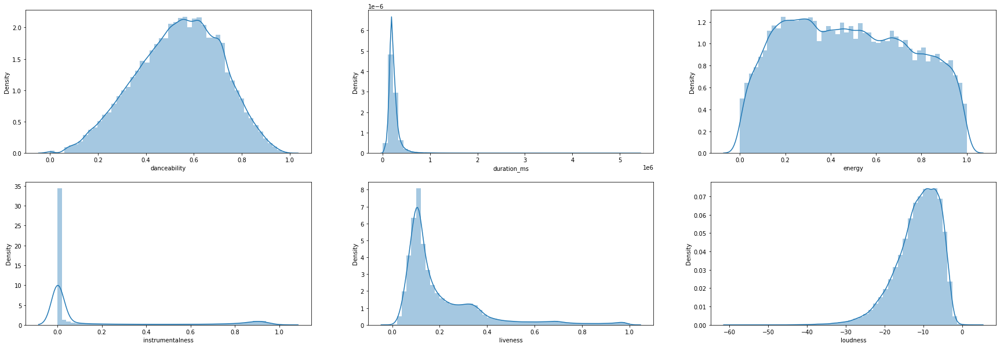

In [8]:
#Plotting various columns of Dataset (Dataset Distribution)
plt.figure(figsize = (30, 10))

plt.subplot(231)
sns.distplot(dataset['danceability'])

plt.subplot(232)
sns.distplot(dataset['duration_ms'])

plt.subplot(233)
sns.distplot(dataset['energy'])

plt.subplot(234)
sns.distplot(dataset['instrumentalness'])

plt.subplot(235)
sns.distplot(dataset['liveness'])

plt.subplot(236)
sns.distplot(dataset['loudness'])

plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass t

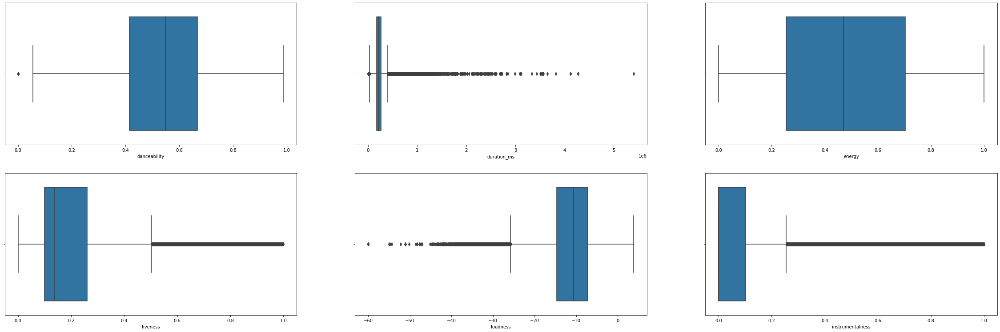

In [9]:
#Visualizing the basic statistics related to every column (Outliers)
plt.figure(figsize = (40, 20))

plt.subplot(331)
sns.boxplot(dataset['danceability'])

plt.subplot(332)
sns.boxplot(dataset['duration_ms'])

plt.subplot(333)
sns.boxplot(dataset['energy'])

plt.subplot(334)
sns.boxplot(dataset['liveness'])

plt.subplot(335)
sns.boxplot(dataset['loudness'])

plt.subplot(336)
sns.boxplot(dataset['instrumentalness'])

plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



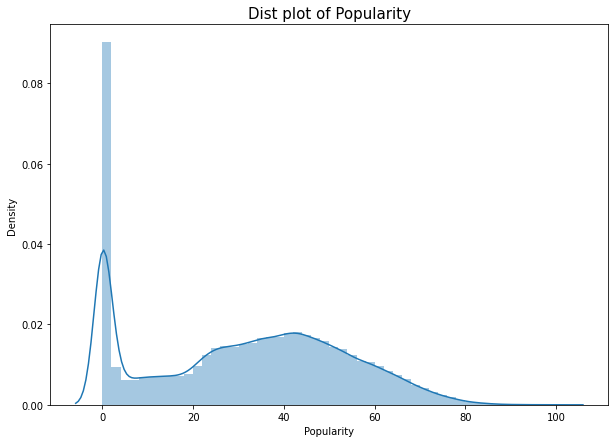

In [10]:
#Probability distribution of "Popularity" column
plt.figure(figsize = (10, 7))

sns.distplot(dataset.popularity)
plt.title("Dist plot of Popularity", fontdict = {'fontsize' : 15})
plt.xlabel('Popularity')
plt.show()

plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



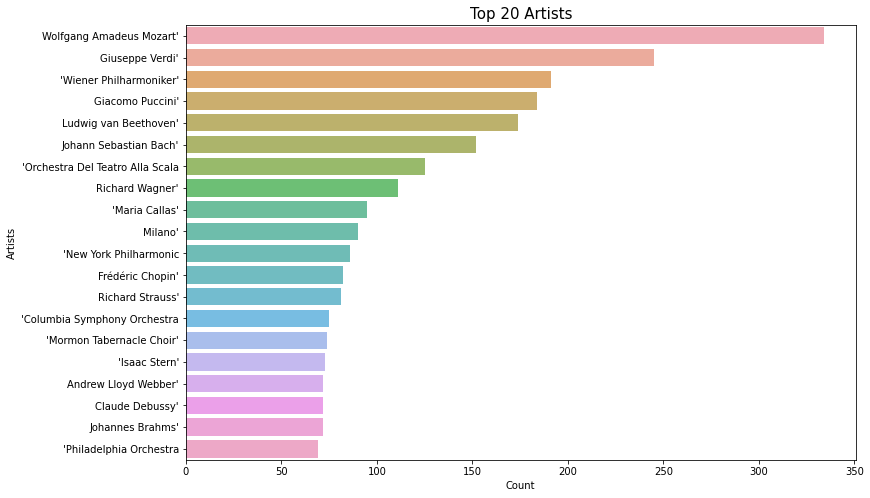

In [11]:
#Display Top 20 Artisits by Song Count
l = []
for i in (dataset.artists):
    a = i[2:-2]
    l.append(a)
l = list(set(l))


lst = []
for i in l:
    res = i.strip('][').split(', ')
    lst.append(res)


d = []
for i in lst:
    for j in i:
        d.append(j)

dff = pd.DataFrame(d)
dff = dff[0].value_counts()
dff = dff[:20, ]

plt.figure(figsize = (12, 8))
sns.barplot(dff.values, dff.index, alpha = 0.8)
plt.title("Top 20 Artists", fontdict = {'fontsize' : 15})
plt.ylabel("Artists")
plt.xlabel("Count")
plt.show()

In [12]:
#Binning 'year' to classify songs based on year
def year(df):
    if (df > 1920) and (df <= 1945):
        return "Post-Great War"
    if (df > 1945) and (df <= 1970):
        return "Retro"
    if (df > 1970) and (df <= 1995):
        return "Modern"
    else:
        return "Post-Modern"

dataset['era'] = dataset['year'].apply(year)
px.pie(data_frame = dataset, names = 'era', hole = 0.2, title = 'Eras of Music')

In [13]:
#Binning 'explicit' to classify songs as explicit or not
def func(df):
    if (df == 1):
        return 'Yes'
    else:
        return 'No'

dataset['isExplicit'] = dataset['explicit'].apply(func)
px.pie(data_frame = dataset, names = 'isExplicit', hole = 0.2, title = 'Explicit')

In [14]:
#Binning 'loudness' to classfiy songs by how loud they are
def loud(row):
    m = dataset['loudness'].median()
    sd = dataset['loudness'].std()

    if row['loudness'] >= m+(1.5*sd):
        return "Extreme"
    elif row['loudness'] >= m+(sd):
        return "Very Loud"
    elif row['loudness'] >= m+(0.5*sd):
        return "Loud"
    elif row['loudness'] >= m-(0.5*sd):
        return "Soft"
    elif row['loudness'] >= m-(sd):
        return "Very Soft"
    else:
        return "Mellow"

dataset['is_loud'] = dataset.apply(lambda row: loud(row), axis=1)
px.pie(data_frame = dataset, names = 'is_loud', hole = 0.2, title = 'IS LOUD')

In [15]:
#Binning 'energy' to classify songs by high/low energy
def energy(row):
    if row['energy'] >= dataset['energy'].mean():
        return "High"
    else:
        return "Low"

dataset['en_type'] = dataset.apply(lambda row: energy(row), axis = 1)
px.pie(names = dataset['en_type'], hole = 0.2)

In [16]:
#Binning 'popularity' to classify songs on the basis of their popularity
def func(df):
    if df > 75:
        return 'Very Popular'
    elif df > 50 and df < 76:
        return 'Popular'
    elif df > 25 and df < 51:
        return 'Average'
    else:
        return 'Not popular'
        
dataset['isPopular'] = dataset['popularity'].apply(func)
px.pie(data_frame = dataset, names = 'isPopular', hole = 0.2, title = 'Popularity')

In [17]:
#EDA- 1: Scatter plot based on Danceability, Loudness, Liveness, and Explicit
fig = px.scatter(dataset, x = "loudness", y = "danceability", size = "liveness", color = "isExplicit",
                 log_x = True, size_max = 30)
fig.show()

In [18]:
#EDA- 2: Artist Name Vs Popularity
art = dataset
n = []
g = []

for name, group in art.groupby(['artists'])['popularity']:
    n.append(name)
    g.append(group.mean())

artist_pop = pd.DataFrame(n,g)

artist_pop.columns = ['Name']
artist_pop['popularity'] = artist_pop.index
artist_pop.sort_values(by = 'popularity',ascending=False,inplace=True)

px.bar(x = artist_pop['Name'].head(10),y = artist_pop['popularity'].head(10)).update_layout(yaxis_title_text = 'Popularity')

In [19]:
#EDA- 3: Top 10 Popular Songs
dataset.sort_values(by = 'popularity', ascending = False, inplace = True)
dff = dataset.head(10)
px.histogram(x = dff.name, y = dff.popularity, color = dff.isExplicit, labels = {'x':'Top 10 songs','y':'Popularity'})

In [20]:
#EDA- 4: Scatter plot of top 20 Songs based on Popularity, Danceability, and Loudness
dff = dataset.head(20)
px.scatter_3d(x = dff.name, y = dff.is_loud, z = dff.danceability, color = dff.popularity, labels = {'x':'name','y':'type','z':'danceability','color':'popularity'})

In [21]:
#EDA- 5: Scatter plot of top 20 Songs based on Popularity, Danceability, and Energy
dff = dataset.head(20)
px.scatter_3d(x = dff.name, y = dff.en_type, z = dff.danceability, color = dff.popularity, labels = {'x':'name','y':'type','z':'danceability','color':'popularity'})

In [22]:
#EDA- 6: Animation of popularity of the data points over years
fig = px.scatter(dataset, x = "popularity", y = "danceability", animation_frame = dataset['year'].sort_values(), animation_group = "isPopular",
           size = "key", color = "isExplicit", hover_name = "isPopular",
           log_x = True, size_max = 45, range_x = [1,101], range_y = [0,1])
fig.show()

#Data PreProcessing



In [23]:
#Encoding Categorical Variables (Dummy Variable Encoding)
isPopular = pd.get_dummies(dataset['isPopular'], drop_first = True)
isExplicit = pd.get_dummies(dataset['isExplicit'], drop_first = True)
isLoud = pd.get_dummies(dataset['is_loud'], drop_first = True)

#Display the encoded dataset
dataset = pd.concat([dataset, isPopular, isExplicit, isLoud], axis = 1)
dataset.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,era,isExplicit,is_loud,en_type,isPopular,Not popular,Popular,Very Popular,Yes,Loud,Mellow,Soft,Very Loud,Very Soft
19611,0.145,2020,0.4010,"['Bad Bunny', 'Jhay Cortez']",0.731,205090,0.573,1,47EiUVwUp4C9fGccaPuUCS,0.000052,4,0.1130,-10.059,0,Dakiti,100,2020-10-30,0.0544,109.928,Post-Modern,Yes,Soft,High,Very Popular,0,0,1,1,0,0,1,0,0
19606,0.756,2020,0.2210,"['24kGoldn', 'iann dior']",0.700,140526,0.722,1,3tjFYV6RSFtuktYl3ZtYcq,0.000000,7,0.2720,-3.558,0,Mood (feat. iann dior),99,2020-07-24,0.0369,90.989,Post-Modern,Yes,Very Loud,High,Very Popular,0,0,1,1,0,0,0,1,0
19618,0.737,2020,0.0112,['BTS'],0.746,199054,0.765,0,0t1kP63rueHleOhQkYSXFY,0.000000,6,0.0936,-4.410,0,Dynamite,97,2020-08-28,0.0993,114.044,Post-Modern,No,Very Loud,High,Very Popular,0,0,1,0,0,0,0,1,0
19608,0.357,2020,0.0194,"['Cardi B', 'Megan Thee Stallion']",0.935,187541,0.454,1,4Oun2ylbjFKMPTiaSbbCih,0.000000,1,0.0824,-7.509,1,WAP (feat. Megan Thee Stallion),96,2020-08-07,0.3750,133.073,Post-Modern,Yes,Loud,Low,Very Popular,0,0,1,1,1,0,0,0,0
19610,0.682,2020,0.4680,['Ariana Grande'],0.737,172325,0.802,1,35mvY5S1H3J2QZyna3TFe0,0.000000,0,0.0931,-4.771,1,positions,96,2020-10-30,0.0878,144.015,Post-Modern,Yes,Very Loud,High,Very Popular,0,0,1,1,0,0,0,1,0


In [24]:
#Remove unwanted columns
dataset.drop(['isPopular', 'isExplicit', 'is_loud', 'era', 'id', 'name','en_type', 'artists', 'release_date', 'duration_ms'], axis = 1, inplace = True)
print(dataset.columns)

Index(['valence', 'year', 'acousticness', 'danceability', 'energy', 'explicit',
       'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity',
       'speechiness', 'tempo', 'Not popular', 'Popular', 'Very Popular', 'Yes',
       'Loud', 'Mellow', 'Soft', 'Very Loud', 'Very Soft'],
      dtype='object')


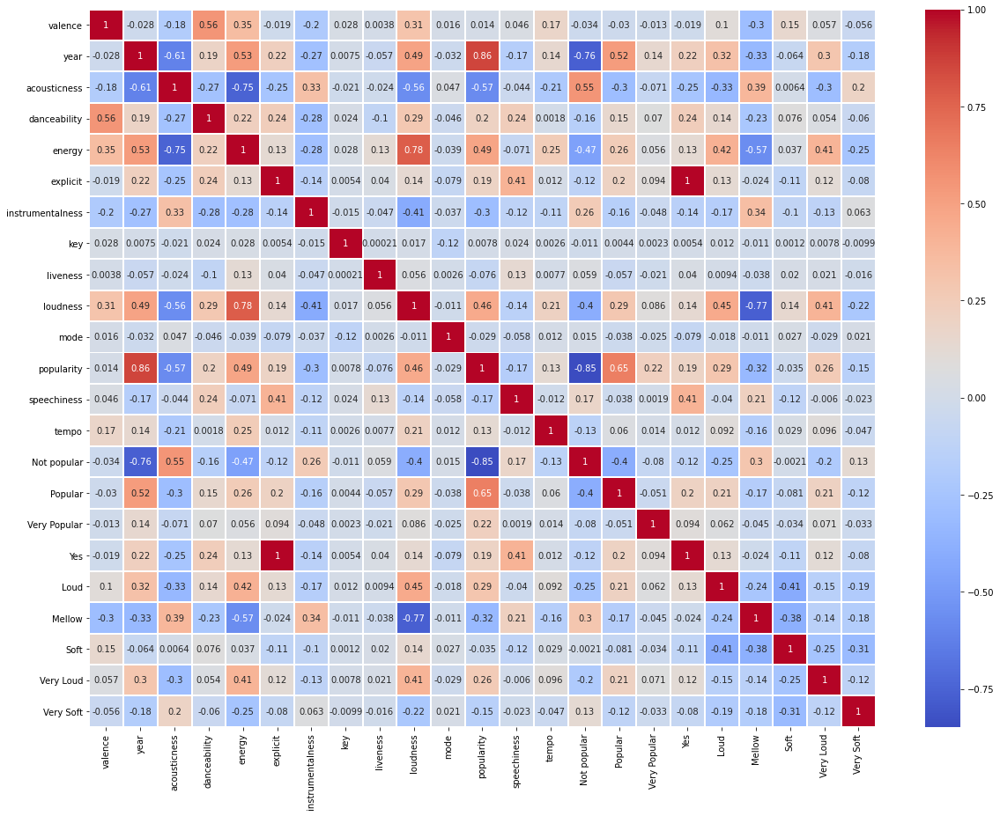

In [25]:
#Correlation Plot (Heatmap)
plt.figure(figsize = (20,15))
sns.heatmap(dataset.corr(),linecolor = 'white', linewidths = 1, cmap = 'coolwarm', annot = True)
plt.show()

#Multiple Linear Regression

In [104]:
#Divide the dataset into dependent and Independent Variables
#Independent Variables
#x = dataset.loc[:, dataset.columns != 'popularity']
new = dataset[["year", "acousticness", "energy", "loudness", "Not popular", "Popular"]].copy()
x = dataset.loc[:, new.columns]

#Dependent Variables
y = dataset.loc[:, dataset.columns == 'popularity']

In [105]:
#Data Balancing using Feature Scaling
sc_x = StandardScaler()
sc_y = StandardScaler()

x = sc_x.fit_transform(x)
y = sc_y.fit_transform(y)

In [106]:
#Train Test Split (Train: 75% and Test: 25%)
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.25, random_state=0)

In [107]:
#Regression
mlr_model = LinearRegression()
mlr_model.fit(x_train, y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

In [108]:
#Data Prediction
mlr_y_pred = mlr_model.predict(x_test)

In [109]:
#Evalate the model using various metrics
print("Training Score of Linear Regression is: {}\n".format(mlr_model.score(x_train, y_train)))
print("R2 Score of Linear Regression is: {}\n".format(r2_score(y_test, mlr_y_pred)))
print("Mean Squared Error of Linear Regression is: {}\n".format(mean_squared_error(y_test, mlr_y_pred)))
print("Mean Absolute Error of Linear Regression is: {}\n".format(mean_absolute_error(y_test, mlr_y_pred)))

Training Score of Linear Regression is: 0.887152316384299

R2 Score of Linear Regression is: 0.8856469253356952

Mean Squared Error of Linear Regression is: 0.11393364363244736

Mean Absolute Error of Linear Regression is: 0.25734870920802744



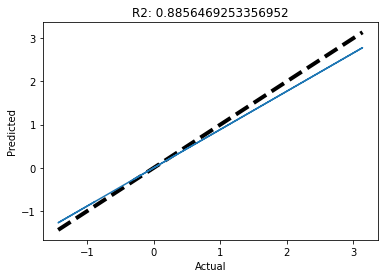

In [110]:
#Linear Regression (R2 Score Plotting)
fig, ax = plt.subplots()
#ax.scatter(y_test, mlr_y_pred)
ax.plot([y.min(), y.max()], [y.min(), y.max()], 'k--', lw=4)
ax.set_xlabel('Actual')
ax.set_ylabel('Predicted')

#Regression Line
y_test, y_predicted = y_test.reshape(-1,1), mlr_y_pred.reshape(-1,1)
ax.plot(y_test, LinearRegression().fit(y_test, mlr_y_pred).predict(y_test))
ax.set_title('R2: ' + str(r2_score(y_test, y_predicted)))
plt.show()